In [73]:
import os
import pickle
import numpy as np
from tensorflow.keras.applications.inception_v3 import InceptionV3, preprocess_input
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.models import Model
from tensorflow.keras.utils import to_categorical, plot_model
from tensorflow.keras.layers import Input, Dense, LSTM, Embedding, Dropout, add

In [74]:
base_model = InceptionV3(weights='imagenet')
model = Model(inputs=base_model.inputs, outputs=base_model.layers[-2].output)
print(model.summary())

96112376/96112376 ━━━━━━━━━━━━━━━━━━━━ 16s 0us/step


Model: "functional_16"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_5       │ (None, 299, 299,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_470 (Conv2D) │ (None, 149, 149,  │        864 │ input_layer_5[0]… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 149, 149,  │         96 │ conv2d_470[0][0]  │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_470      │ (None, 149, 149,  │          0 │ batch_normalizat… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_471 (Conv2D) │ (None, 147, 147,  │      9,216 │ activation_470[0… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 147, 147,  │         96 │ conv2d_471[0][0]  │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_471      │ (None, 147, 147,  │          0 │ batch_normalizat… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_472 (Conv2D) │ (None, 147, 147,  │     18,432 │ activation_471[0… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 147, 147,  │        192 │ conv2d_472[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_472      │ (None, 147, 147,  │          0 │ batch_normalizat… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_20    │ (None, 73, 73,    │          0 │ activation_472[0… │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_473 (Conv2D) │ (None, 73, 73,    │      5,120 │ max_pooling2d_20… │
│                     │ 80)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 73, 73,    │        240 │ conv2d_473[0][0]  │
│ (BatchNormalizatio… │ 80)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_473      │ (None, 73, 73,    │          0 │ batch_normalizat… │
│ (Activation)        │ 80)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_474 (Conv2D) │ (None, 71, 71,    │    138,240 │ activation_473[0… │
│                     │ 192)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 71, 71,    │        576 │ conv2d_474[0][0]  │
│ (BatchNormalizatio… │ 192)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_474      │ (None, 71, 71,    │          0 │ batch_normalizat

 Total params: 21,802,784 (83.17 MB)

 Trainable params: 21,768,352 (83.04 MB)

 Non-trainable params: 34,432 (134.50 KB)

None


In [76]:
features = {}
directory = os.path.join('30kdataset/flickr30k_images/flickr30k_images')
for img_name in os.listdir(directory):
    img_path = os.path.join(directory, img_name)
    image = load_img(img_path, target_size=(299, 299))
    image = img_to_array(image)
    image = np.expand_dims(image, axis=0)
    image = preprocess_input(image)
    feature = model.predict(image, verbose=0)
    image_id = img_name.split('.')[0]
    features[image_id] = feature

In [77]:
with open('features.pkl', 'wb') as f:
    pickle.dump(features, f)

In [101]:
with open('features.pkl', 'rb') as f:
    features = pickle.load(f)

with open('30kdataset/flickr30k_images/results.csv', 'r', encoding='utf-8') as f:
    next(f)
    captions_doc = f.read()

mapping = {}
for line in captions_doc.split('\n'):
    tokens = line.split('|')
    if len(line) < 2:
        continue
    image_id, caption = tokens[0], tokens[2:]
    image_id = image_id.split('.')[0]
    caption = " ".join(caption)
    if image_id not in mapping:
        mapping[image_id] = []
    mapping[image_id].append(caption)

import re

def clean(mapping):
    for key, captions in mapping.items():
        for i in range(len(captions)):
            caption = captions[i].lower()
            print(caption)
            caption = re.sub('[^a-zA-Z]', ' ', caption)
            caption = re.sub('\s+', ' ', caption)
            caption = 'startseq ' + " ".join([word for word in caption.split() if len(word) > 1]) + ' endseq'
            captions[i] = caption

clean(mapping)

 two young guys with shaggy hair look at their hands while hanging out in the yard .
 two young , white males are outside near many bushes .
 two men in green shirts are standing in a yard .
 a man in a blue shirt standing in a garden .
 two friends enjoy time spent together .
 several men in hard hats are operating a giant pulley system .
 workers look down from up above on a piece of equipment .
 two men working on a machine wearing hard hats .
 four men on top of a tall structure .
 three men on a large rig .
 a child in a pink dress is climbing up a set of stairs in an entry way .
 a little girl in a pink dress going into a wooden cabin .
 a little girl climbing the stairs to her playhouse .
 a little girl climbing into a wooden playhouse 
 a girl going into a wooden building .
 someone in a blue shirt and hat is standing on stair and leaning against a window .
 a man in a blue shirt is standing on a ladder cleaning a window .
 a man on a ladder cleans the window of a tall building

In [102]:
print(mapping['1000092795'])

['startseq two young guys with shaggy hair look at their hands while hanging out in the yard endseq', 'startseq two young white males are outside near many bushes endseq', 'startseq two men in green shirts are standing in yard endseq', 'startseq man in blue shirt standing in garden endseq', 'startseq two friends enjoy time spent together endseq']


In [103]:
all_captions = []
for key in mapping:
    for caption in mapping[key]:
        all_captions.append(caption)

In [104]:
print(all_captions[:5])

['startseq two young guys with shaggy hair look at their hands while hanging out in the yard endseq', 'startseq two young white males are outside near many bushes endseq', 'startseq two men in green shirts are standing in yard endseq', 'startseq man in blue shirt standing in garden endseq', 'startseq two friends enjoy time spent together endseq']


In [105]:
tokenizer = Tokenizer()
tokenizer.fit_on_texts(all_captions)
vocab_size = len(tokenizer.word_index) + 1
max_length = max(len(caption.split()) for caption in all_captions)

image_ids = list(mapping.keys())
split = int(len(image_ids) * 0.90)
train = image_ids[:split]
test = image_ids[split:]

In [107]:
def data_generator(data_keys, mapping, features, tokenizer, max_length, vocab_size, batch_size):
    X1, X2, y = list(), list(), list()
    n = 0
    while 1:
        for key in data_keys:
            n += 1
            captions = mapping[key]
            for caption in captions:
                seq = tokenizer.texts_to_sequences([caption])[0]
                for i in range(1, len(seq)):
                    in_seq, out_seq = seq[:i], seq[i]
                    in_seq = pad_sequences([in_seq], maxlen=max_length)[0]
                    out_seq = to_categorical([out_seq], num_classes=vocab_size)[0]
                    X1.append(features[key][0])
                    X2.append(in_seq)
                    y.append(out_seq)
            if n == batch_size:
                X1, X2, y = np.array(X1), np.array(X2), np.array(y)
                yield {"image": X1, "text": X2}, y
                X1, X2, y = list(), list(), list()
                n = 0

In [108]:
nputs1 = Input(shape=(2048,), name="image")
fe1 = Dropout(0.4)(inputs1)
fe2 = Dense(256, activation='relu')(fe1)
inputs2 = Input(shape=(max_length,), name="text")
se1 = Embedding(vocab_size, 256, mask_zero=True)(inputs2)
se2 = Dropout(0.4)(se1)
se3 = LSTM(256)(se2)
decoder1 = add([fe2, se3])
decoder2 = Dense(256, activation='relu')(decoder1)
outputs = Dense(vocab_size, activation='softmax')(decoder2)

In [109]:
model = Model(inputs=[inputs1, inputs2], outputs=outputs)
model.compile(loss='categorical_crossentropy', optimizer='adam')


In [112]:
epochs = 10
batch_size = 32
steps = len(train) // batch_size

for i in range(epochs):
    generator = data_generator(train, mapping, features, tokenizer, max_length, vocab_size, batch_size)
    model.fit(generator, epochs=1, steps_per_epoch=steps, verbose=1)

893/893 ━━━━━━━━━━━━━━━━━━━━ 2782s 3s/step - loss: 4.9620
893/893 ━━━━━━━━━━━━━━━━━━━━ 2864s 3s/step - loss: 3.8060
893/893 ━━━━━━━━━━━━━━━━━━━━ 2829s 3s/step - loss: 3.5218
893/893 ━━━━━━━━━━━━━━━━━━━━ 2701s 3s/step - loss: 3.3470
893/893 ━━━━━━━━━━━━━━━━━━━━ 2678s 3s/step - loss: 3.2205
893/893 ━━━━━━━━━━━━━━━━━━━━ 2670s 3s/step - loss: 3.1198
893/893 ━━━━━━━━━━━━━━━━━━━━ 2656s 3s/step - loss: 3.0406
893/893 ━━━━━━━━━━━━━━━━━━━━ 2650s 3s/step - loss: 2.9778
893/893 ━━━━━━━━━━━━━━━━━━━━ 2678s 3s/step - loss: 2.9261
893/893 ━━━━━━━━━━━━━━━━━━━━ 2680s 3s/step - loss: 2.8832


In [113]:
def idx_to_word(integer, tokenizer):
    for word, index in tokenizer.word_index.items():
        if index == integer:
            return word
    return None

In [116]:
def predict_caption(model, image, tokenizer, max_length):
    in_text = 'startseq'
    for i in range(max_length):
        sequence = tokenizer.texts_to_sequences([in_text])[0]
        sequence = pad_sequences([sequence], max_length)
        yhat = model.predict([image, sequence], verbose=0)
        yhat = np.argmax(yhat)
        word = idx_to_word(yhat, tokenizer)
        if word is None:
            break
        in_text += " " + word
        if word == 'endseq':
            break
    return in_text

In [118]:
from nltk.translate.bleu_score import corpus_bleu
actual, predicted = list(), list()

for key in test:
    captions = mapping[key]
    y_pred = predict_caption(model, features[key], tokenizer, max_length)
    actual_captions = [caption.split() for caption in captions]
    y_pred = y_pred.split()
    actual.append(actual_captions)
    predicted.append(y_pred)

print("BLEU-1: %f" % corpus_bleu(actual, predicted, weights=(1.0, 0, 0, 0)))
print("BLEU-2: %f" % corpus_bleu(actual, predicted, weights=(0.5, 0.5, 0, 0)))

BLEU-1: 0.562826
BLEU-2: 0.310005


In [119]:
print(all_captions[0])

startseq two young guys with shaggy hair look at their hands while hanging out in the yard endseq


In [120]:
print(mapping)

{'1000092795': ['startseq two young guys with shaggy hair look at their hands while hanging out in the yard endseq', 'startseq two young white males are outside near many bushes endseq', 'startseq two men in green shirts are standing in yard endseq', 'startseq man in blue shirt standing in garden endseq', 'startseq two friends enjoy time spent together endseq'], '10002456': ['startseq several men in hard hats are operating giant pulley system endseq', 'startseq workers look down from up above on piece of equipment endseq', 'startseq two men working on machine wearing hard hats endseq', 'startseq four men on top of tall structure endseq', 'startseq three men on large rig endseq'], '1000268201': ['startseq child in pink dress is climbing up set of stairs in an entry way endseq', 'startseq little girl in pink dress going into wooden cabin endseq', 'startseq little girl climbing the stairs to her playhouse endseq', 'startseq little girl climbing into wooden playhouse endseq', 'startseq gir

In [129]:
#This is to save the model , it will get saved in the root directory
model.save('IC_MODEL.keras')

#To load the model , do this , make sure the model is in the root directory as well
from tensorflow.keras.models import load_model
loaded_model = load_model('IC_MODEL.keras')
#changes saved

In [121]:
from PIL import Image
import matplotlib.pyplot as plt
def generate_caption(image_name):
    image_id = image_name.split('.')[0]
    img_path = os.path.join("30kdataset/flickr30k_images/flickr30k_images", image_name)
    image = Image.open(img_path)
    captions = mapping[image_id]
    print('---------------------Actual---------------------')
    for caption in captions:
        print(caption)
    y_pred = predict_caption(model, features[image_id], tokenizer, max_length)
    print('--------------------Predicted--------------------')
    print(y_pred)
    plt.imshow(image)

---------------------Actual---------------------
startseq skydiver hangs from the undercarriage of an airplane or some sort of air gliding device endseq
startseq person is hanging on to the bottom of an airplane preparing to skydive endseq
startseq person flying in air wearing sandals goggles and wind suit endseq
startseq someone is hanging on to plane high up in the air endseq
startseq here is stuntman hanging from helicopter endseq
--------------------Predicted--------------------
startseq man in blue jumpsuit is standing on the side of the road endseq


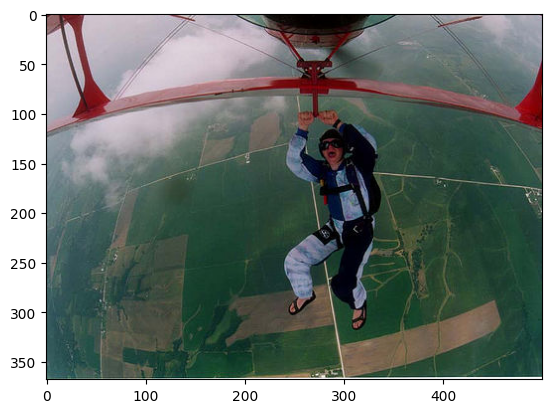

In [128]:
generate_caption('726414.jpg')

In [124]:
def predict_output_caption(image_name):
    image_id = image_name.split('.')[0]
    img_path = os.path.join('30kdataset/flickr30k_images/flickr30k_images', image_name)
    image = Image.open(img_path)
    y_pred = predict_caption(model, features[image_id], tokenizer, max_length)
    print(y_pred)
    return y_pred

predict_output_caption('8601145.jpg')

startseq two men in boat dangle from cruise ship docking endseq


'startseq two men in boat dangle from cruise ship docking endseq'

In [149]:
base_model = InceptionV3(weights='imagenet')
feature_extractor_model = Model(inputs=base_model.inputs, outputs=base_model.layers[-2].output)

In [154]:
def custom_function(image_name):
    img_path = os.path.join('custom images', image_name).replace("\\", "/")
    print(f"Attempting to load image from: {img_path}")
    if not os.path.isfile(img_path):
        raise FileNotFoundError(f"The file {img_path} does not exist.")
    image = load_img(img_path, target_size=(299, 299))
    image = img_to_array(image)
    image = np.expand_dims(image, axis=0)
    image = preprocess_input(image)
    
    feature = feature_extractor_model.predict(image, verbose=0)
    
    y_pred = predict_caption(model, feature, tokenizer, max_length)
    print(y_pred)
    return y_pred

In [153]:
custom_function('biker2.jpeg')

Attempting to load image from: custom images/biker2.jpeg
startseq man in red shirt and blue helmet is riding on the beach endseq


'startseq man in red shirt and blue helmet is riding on the beach endseq'